In [163]:
import tensorflow as tf 
import os
import cv2
import imghdr
import numpy as np
from matplotlib import pyplot as plt 

In [164]:
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu,True)

In [165]:
data_dir = 'data'
image_exts = ['jpeg','jpg','png']
image_exts

['jpeg', 'jpg', 'png']

In [146]:
for image_class in os.listdir(data_dir):
    for image in os.listdir(os.path.join(data_dir,image_class)):
        img_path = os.path.join(data_dir,image_class,image)
        try:
            img = cv2.imread(img_path)
            tip = imghdr.what(img_path)
            if tip not in image_exts:
                print("Image not in exist list {}".format(img_path))
                os.remove(img_path)
        except Exception as e:
            print("Issue with image {}".format(img_path))

In [166]:
data = tf.keras.utils.image_dataset_from_directory('data',label_mode='categorical')

Found 4999 files belonging to 5 classes.


In [167]:
data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 5), dtype=tf.float32, name=None))>

In [168]:
data_iterator = data.as_numpy_iterator()

In [169]:
batch = data_iterator.next()

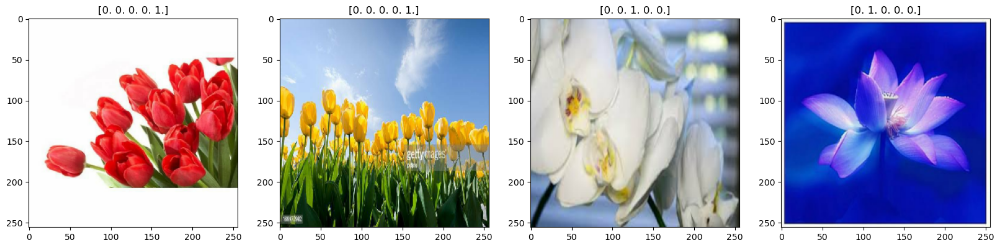

In [151]:
fig,ax = plt.subplots(ncols=4,figsize=(20,20))
for idx, img in enumerate(batch[0][:4]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(batch[1][idx])

In [170]:
data = data.map(lambda x, y: (x/255,y))

In [171]:
data.as_numpy_iterator().next()[0].min()

0.0

In [172]:
len(data)

157

In [173]:
train_size = int(len(data)*0.7)
val_size = int(len(data)*0.2)+1
test_size = int(len(data)*0.1)+1

In [174]:
train_size + val_size + test_size

157

In [175]:
train = data.take(train_size)
val = data.skip(train_size).take(val_size)
test = data.skip(train_size + val_size).take(test_size)

In [110]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D,MaxPooling2D,Dense,Flatten,Dropout

In [19]:
model = Sequential()

In [20]:
model.add(Conv2D(32,(3,3),padding='same',activation='relu',input_shape=(256,256,3)))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(64,(3,3),padding='same',activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

model.add(Conv2D(64,(3,3),padding='same',activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

model.add(Conv2D(128,(3,3),padding='same',activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

model.add(Flatten())
model.add(Dense(512,activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(5,activation='softmax'))          

In [21]:
model.compile(optimizer='adam', 
              loss='categorical_crossentropy', 
              metrics=['accuracy'],
             )

In [22]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 256, 256, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 128, 128, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 64, 64, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 64, 64, 64)        36928     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 32, 32, 64)       0

LOG

In [23]:
logdir = 'logs'

In [24]:
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)

In [25]:
hist = model.fit(train,epochs=30,validation_data=val,callbacks=[tensorboard_callback])

Epoch 1/30
109/109 [==============================] - 107s 970ms/step - loss: 1.4548 - accuracy: 0.3830 - val_loss: 1.1814 - val_accuracy: 0.5000
Epoch 2/30
109/109 [==============================] - 106s 969ms/step - loss: 1.1530 - accuracy: 0.5183 - val_loss: 1.0983 - val_accuracy: 0.5674
Epoch 3/30
109/109 [==============================] - 106s 972ms/step - loss: 1.0376 - accuracy: 0.5780 - val_loss: 1.0623 - val_accuracy: 0.5977
Epoch 4/30
109/109 [==============================] - 108s 988ms/step - loss: 0.9234 - accuracy: 0.6388 - val_loss: 0.9392 - val_accuracy: 0.6299
Epoch 5/30
109/109 [==============================] - 108s 987ms/step - loss: 0.7693 - accuracy: 0.7127 - val_loss: 0.7495 - val_accuracy: 0.7314
Epoch 6/30
109/109 [==============================] - 106s 972ms/step - loss: 0.5624 - accuracy: 0.7964 - val_loss: 0.7253 - val_accuracy: 0.7529
Epoch 7/30
109/109 [==============================] - 106s 970ms/step - loss: 0.4527 - accuracy: 0.8360 - val_loss: 0.6791 -

In [29]:
from tensorflow.keras.models import load_model
model.save('Model.h5')

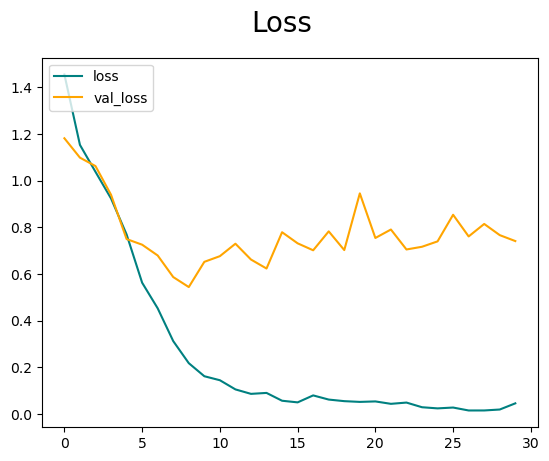

In [30]:
fig = plt.figure()
plt.plot(hist.history['loss'],color='teal',label='loss')
plt.plot(hist.history['val_loss'],color='orange',label='val_loss')
fig.suptitle('Loss',fontsize=20)
plt.legend(loc='upper left')
plt.show()

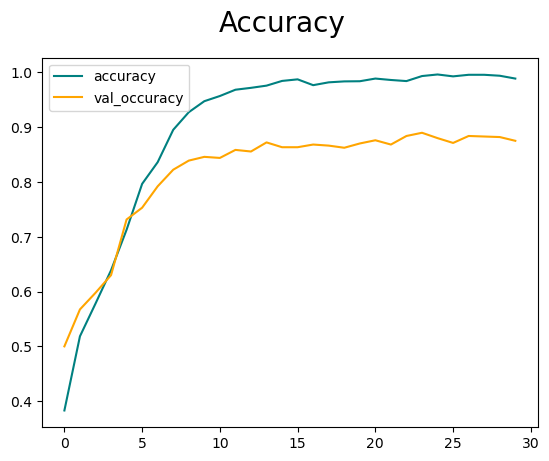

In [31]:
fig = plt.figure()
plt.plot(hist.history['accuracy'],color='teal',label='accuracy')
plt.plot(hist.history['val_accuracy'],color='orange',label='val_accuracy')
fig.suptitle('Accuracy',fontsize=20)
plt.legend(loc='upper left')
plt.show()

In [52]:
test_loss, test_accuracy = model.evaluate(test)
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

16/16 [==============================] - 6s 202ms/step - loss: 0.8959 - accuracy: 0.8563
Test Loss: 0.8958597779273987
Test Accuracy: 0.8562628626823425


In [89]:
from sklearn.metrics import classification_report

1/1 [==============================] - 0s 301ms/step


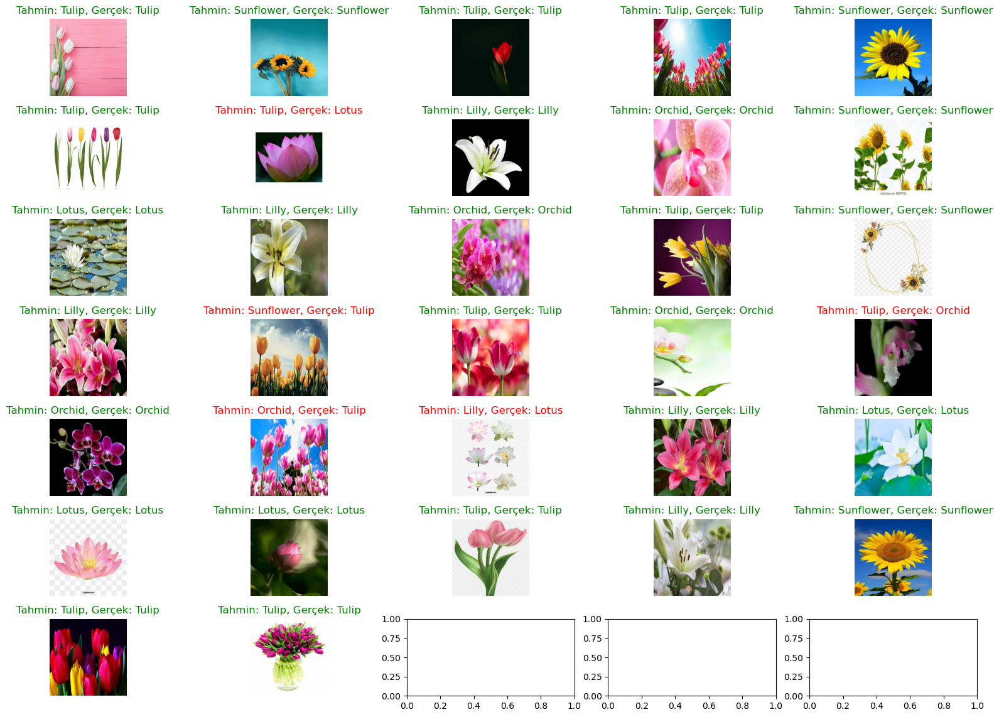

1/1 [==============================] - 0s 236ms/step


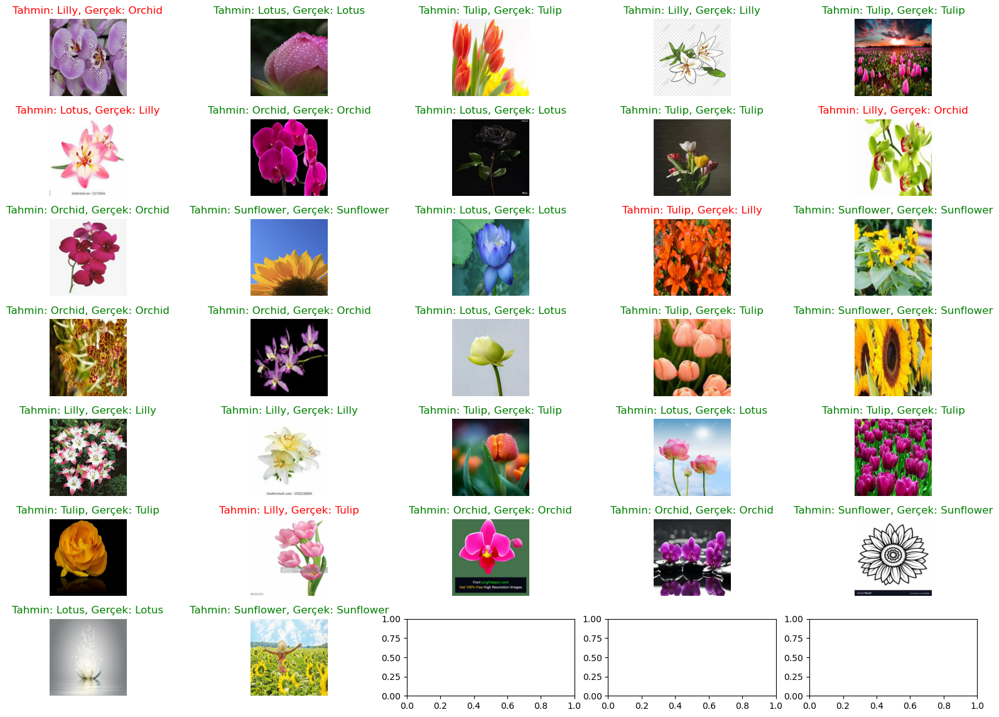

1/1 [==============================] - 0s 235ms/step


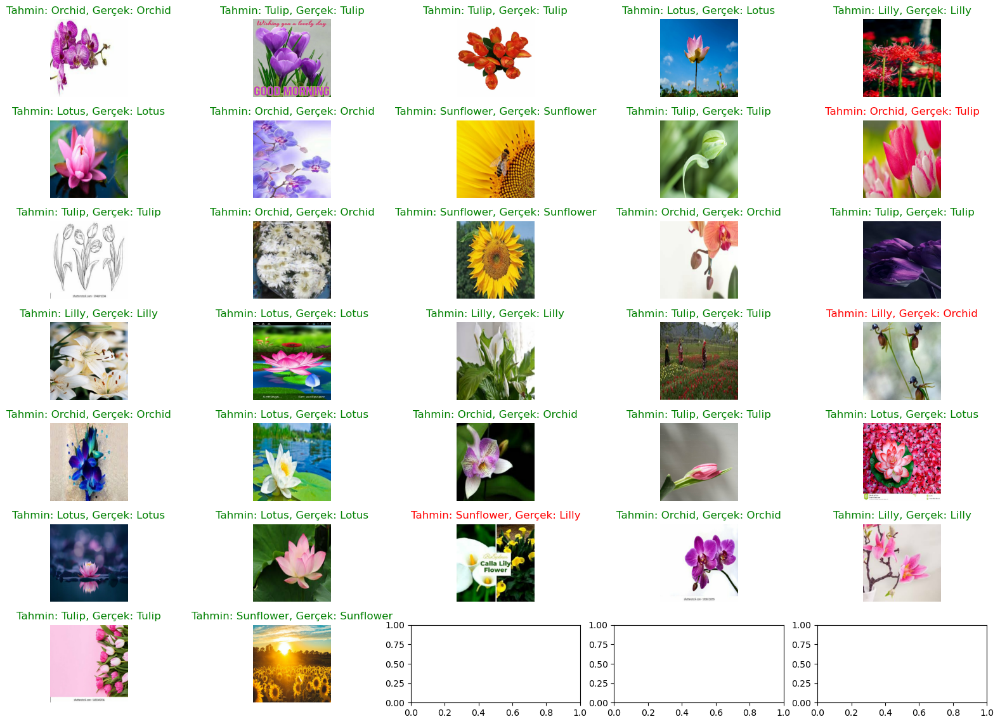

1/1 [==============================] - 0s 226ms/step


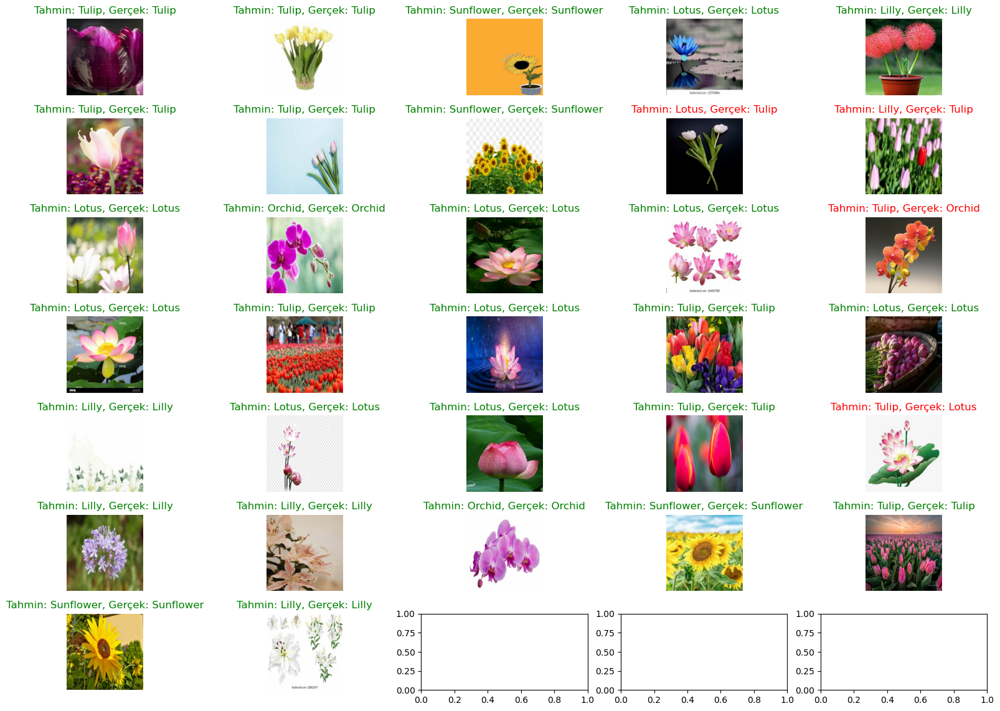

1/1 [==============================] - 0s 233ms/step


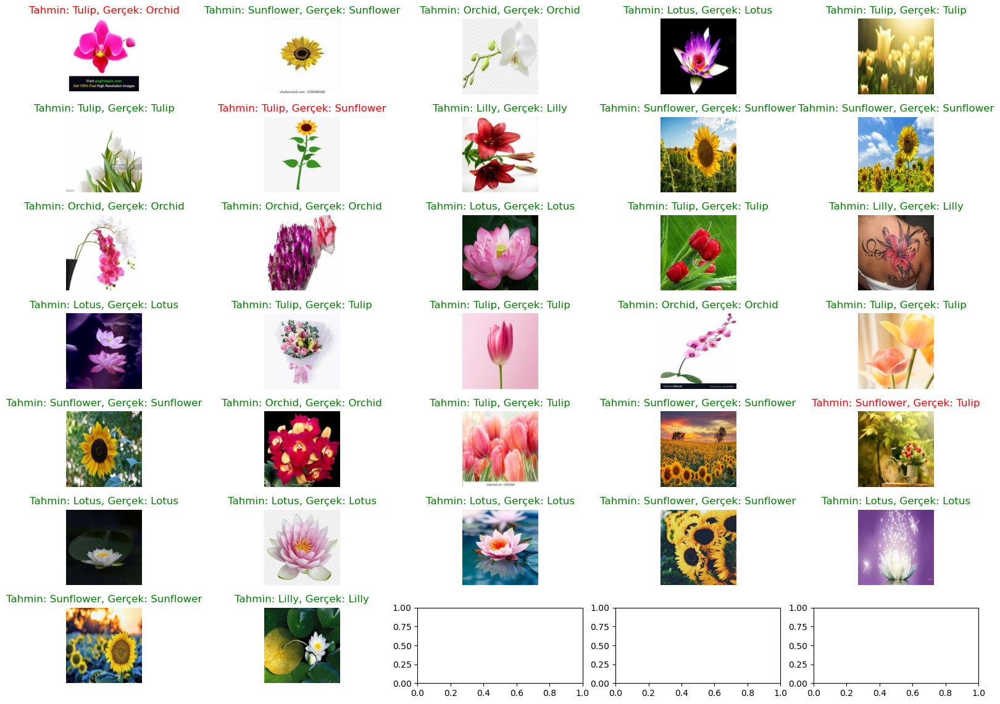

1/1 [==============================] - 0s 227ms/step


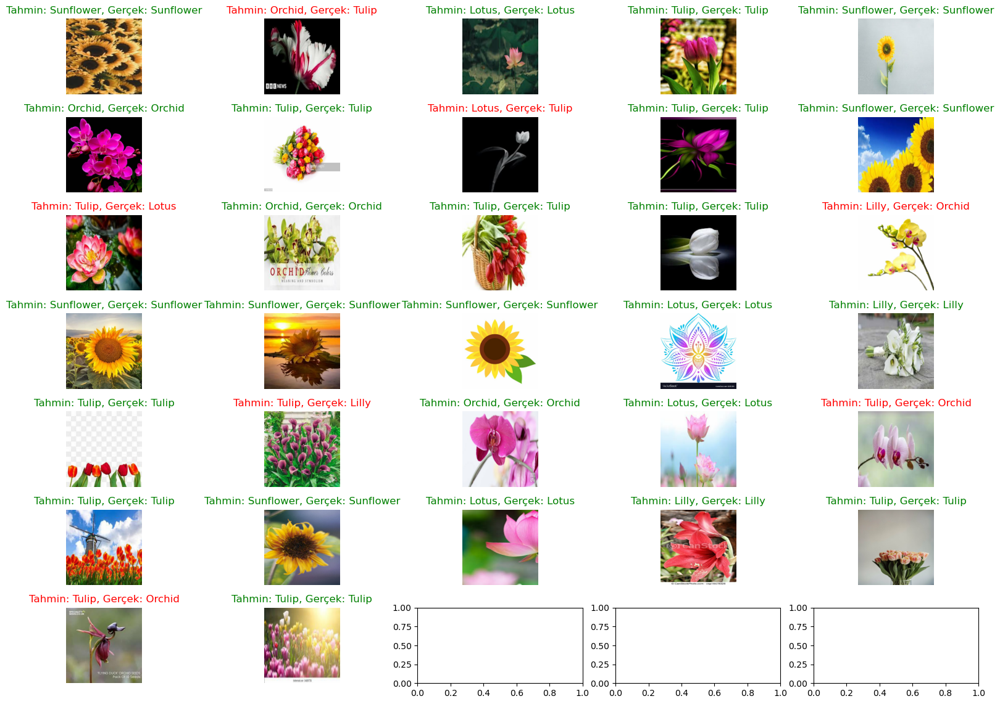

1/1 [==============================] - 0s 228ms/step


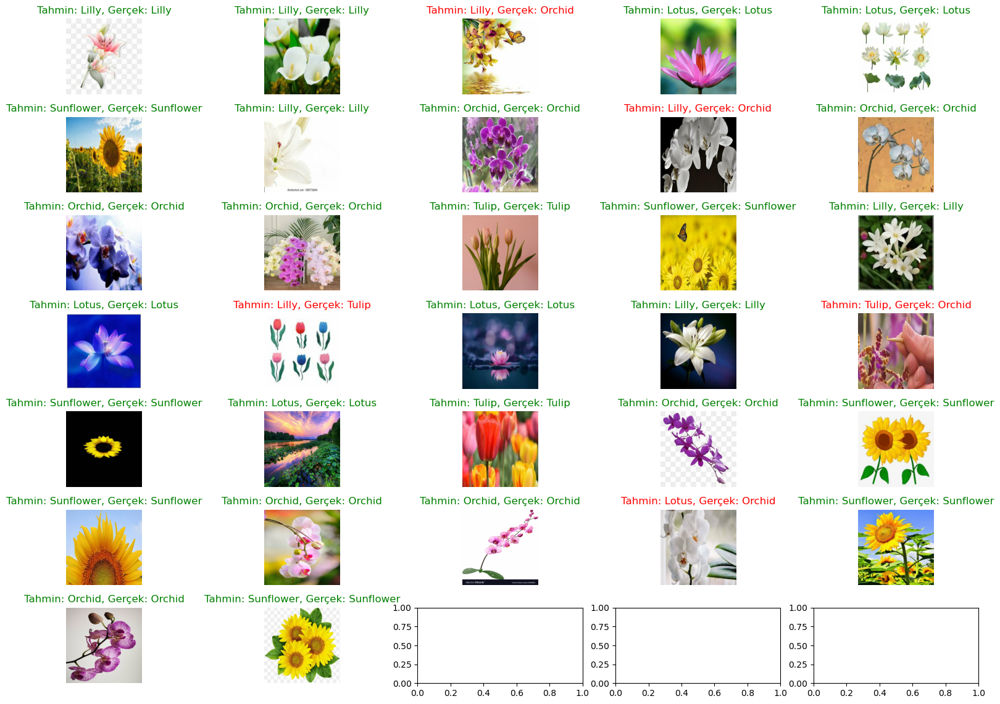

1/1 [==============================] - 0s 238ms/step


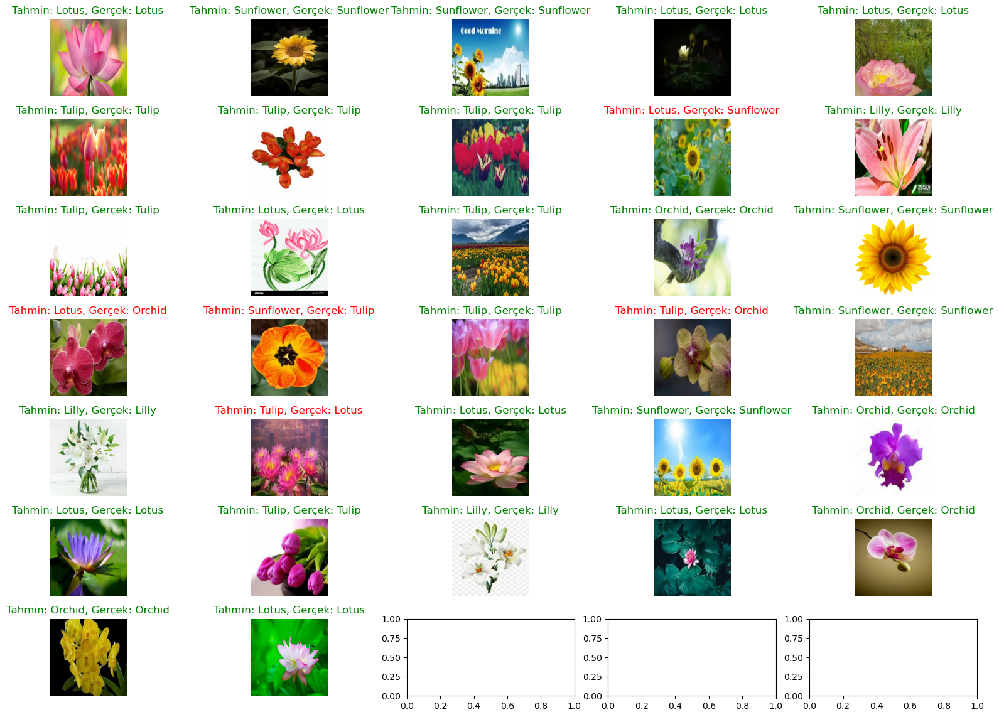

1/1 [==============================] - 0s 238ms/step


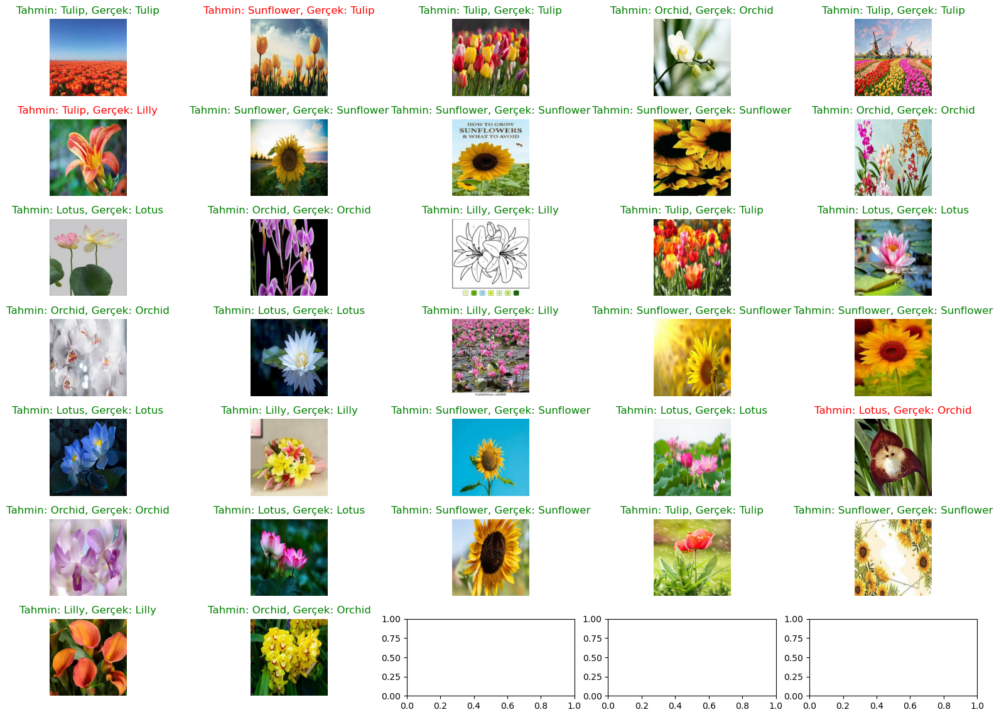

1/1 [==============================] - 0s 238ms/step


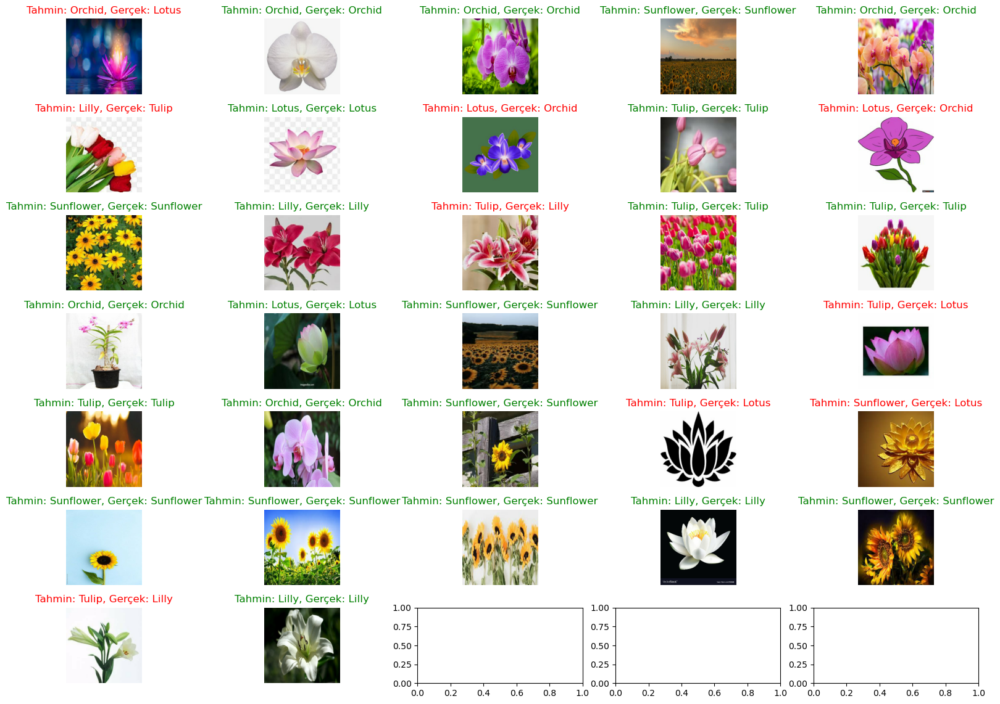

1/1 [==============================] - 0s 240ms/step


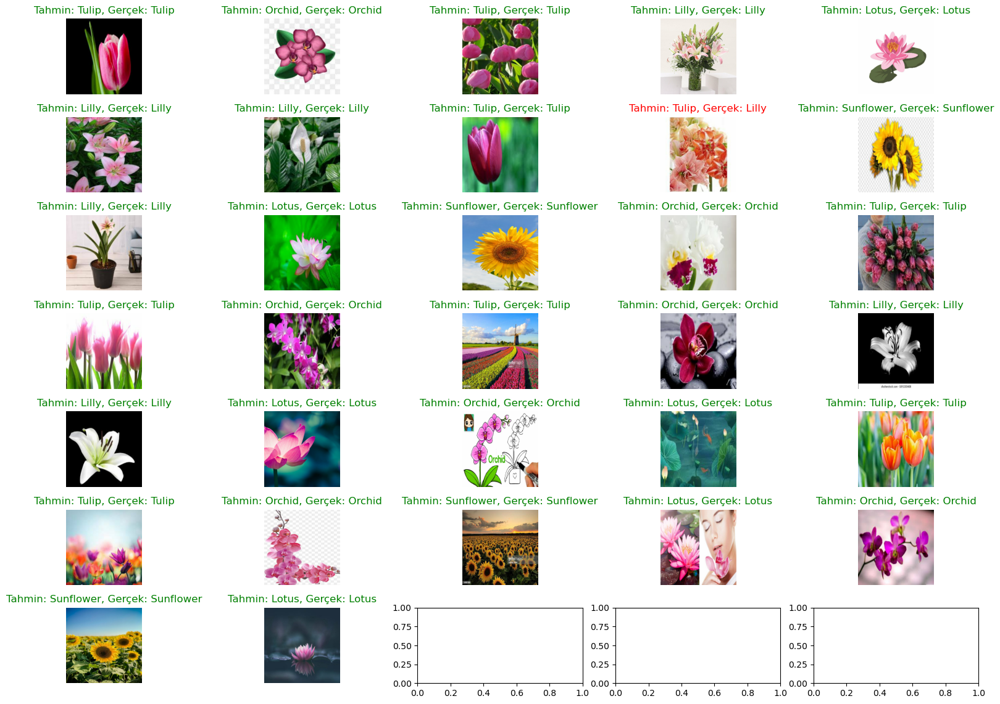

1/1 [==============================] - 0s 241ms/step


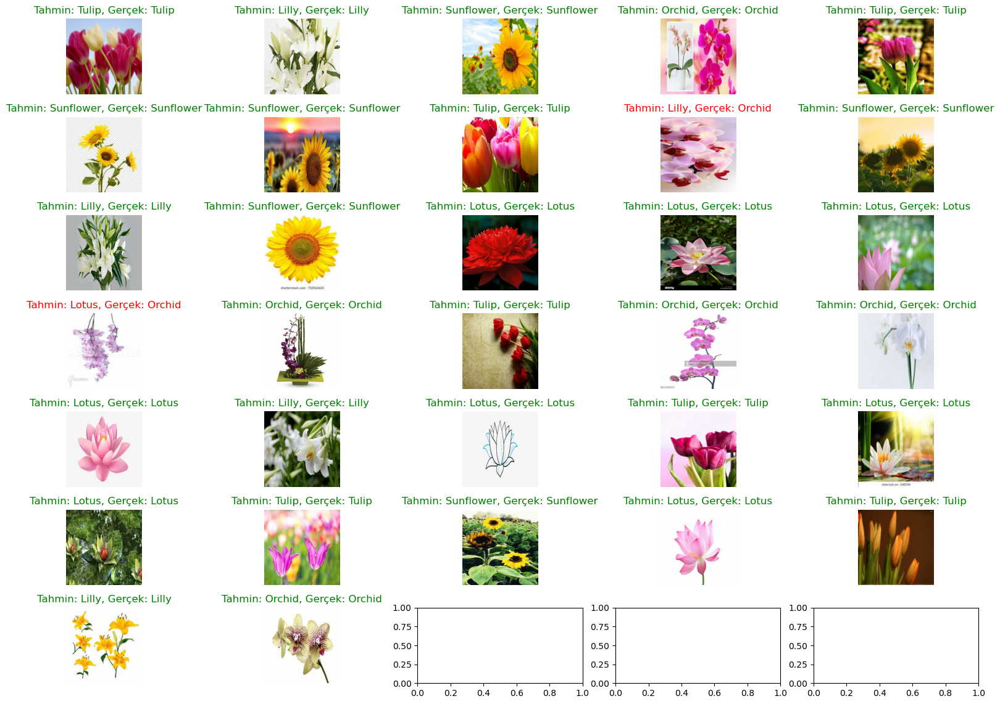

1/1 [==============================] - 0s 230ms/step


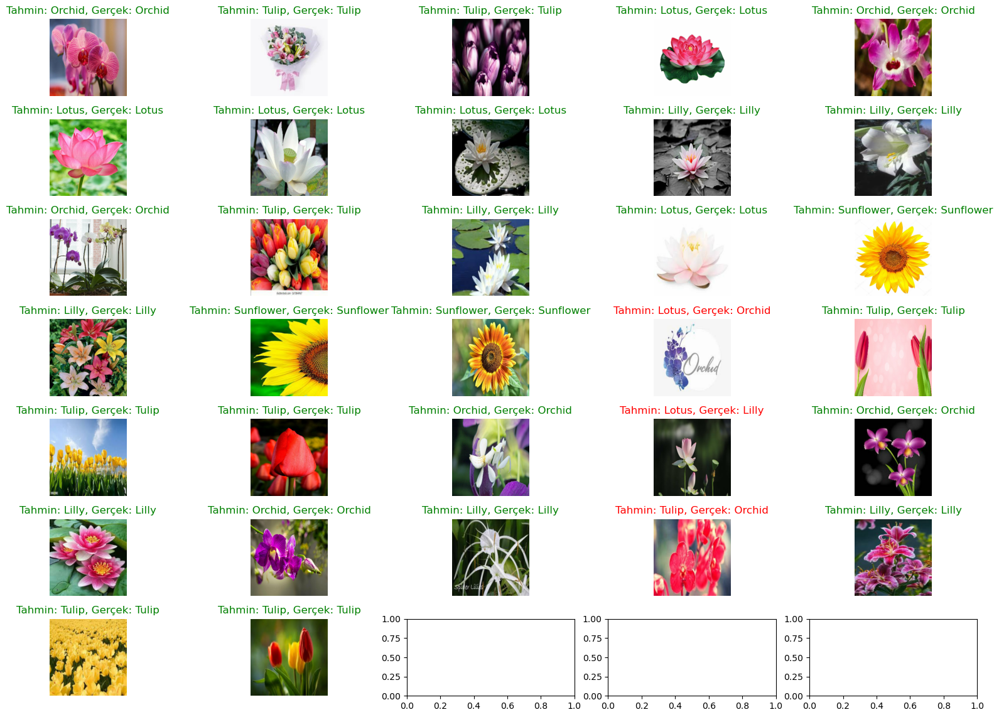

1/1 [==============================] - 0s 235ms/step


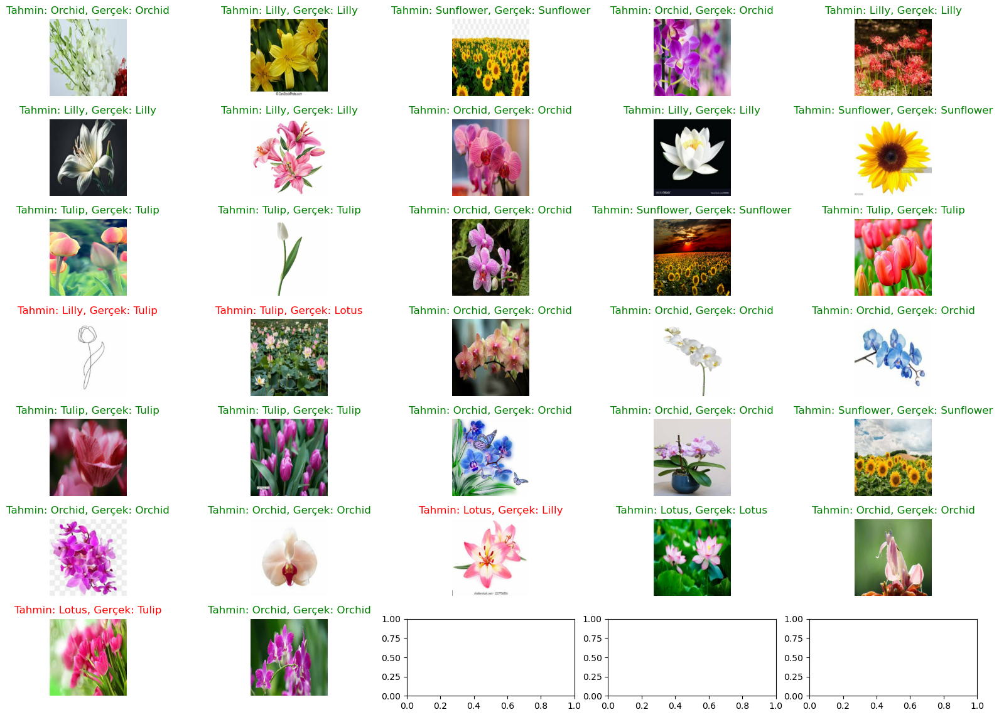

1/1 [==============================] - 0s 240ms/step


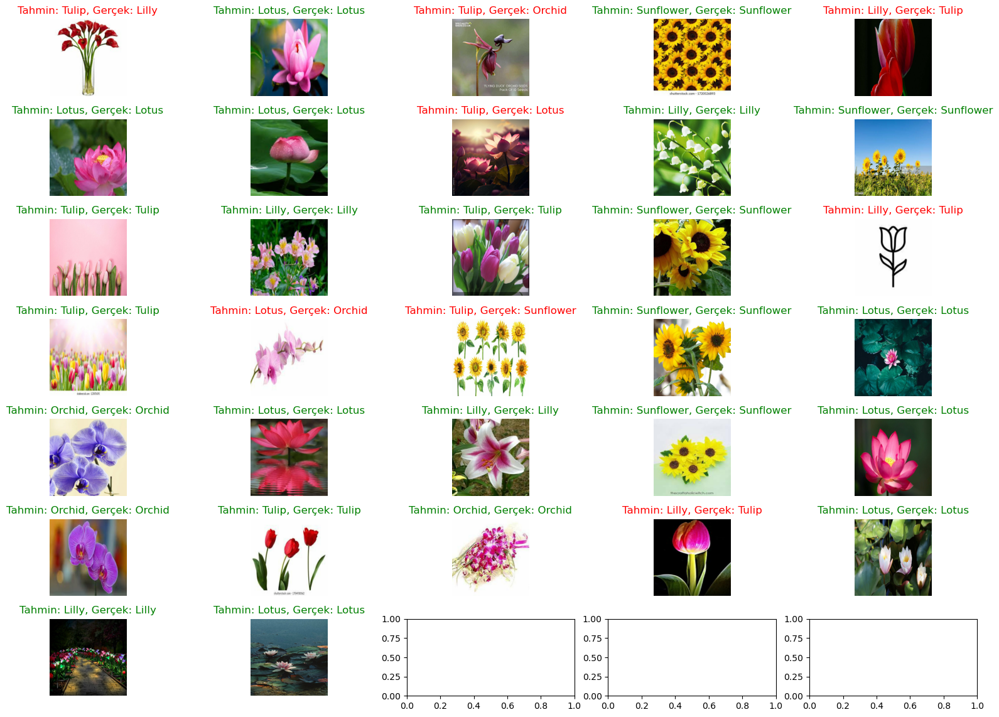

1/1 [==============================] - 0s 67ms/step


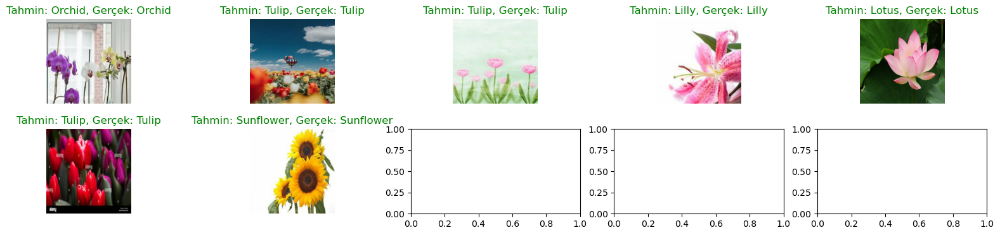

In [90]:
num_images_per_row = 5

for images, labels in test:
    predictions = model.predict(images)
    predicted_labels = np.argmax(predictions, axis=1)
    true_labels = np.argmax(labels, axis=1)
    report = classification_report(true_labels, predicted_labels, target_names=image_classes)
    
    num_images = len(images)
    num_rows = int(np.ceil(num_images / num_images_per_row))
    
    fig, axs = plt.subplots(num_rows, num_images_per_row, figsize=(20, 2*num_rows))
    fig.subplots_adjust(hspace=0.3)
    
    for i in range(num_rows):
        for j in range(num_images_per_row):
            index = i * num_images_per_row + j
            if index < num_images:
                image = (images[index] * 255).numpy().astype(np.uint8)
                ax = axs[i, j]
                ax.imshow(image)
                ax.axis('off')
                if predicted_labels[index] != true_labels[index]:
                    ax.set_title("Tahmin: {}, Gerçek: {}".format(image_classes[predicted_labels[index]], image_classes[true_labels[index]]), color='red')
                else:
                    ax.set_title("Tahmin: {}, Gerçek: {}".format(image_classes[predicted_labels[index]], image_classes[true_labels[index]]), color='green')
    
    plt.show()

In [92]:
from sklearn.metrics import accuracy_score, precision_score, recall_score

predicted_labels_all = []
true_labels_all = []

for images, labels in test:
    predictions = model.predict(images)
    predicted_labels_batch = np.argmax(predictions, axis=1)
    true_labels_batch = np.argmax(labels, axis=1)
    
    predicted_labels_all.extend(predicted_labels_batch)
    true_labels_all.extend(true_labels_batch)

accuracy = accuracy_score(true_labels_all, predicted_labels_all)
precision = precision_score(true_labels_all, predicted_labels_all, average='weighted')
recall = recall_score(true_labels_all, predicted_labels_all, average='weighted')

print("Toplam Doğruluk (Accuracy):", accuracy)
print("Toplam Hassasiyet (Precision):", precision)
print("Toplam Duyarlılık (Recall):", recall)

1/1 [==============================] - 0s 66ms/step
Toplam Doğruluk (Accuracy): 0.86652977412731
Toplam Hassasiyet (Precision): 0.8732621910000203
Toplam Duyarlılık (Recall): 0.86652977412731


In [177]:
from tensorflow.keras.applications.vgg16 import VGG16 # C
from tensorflow.keras.optimizers import Adam

In [178]:
input_shape = (224, 224, 3)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=input_shape)

for layer in base_model.layers:
    layer.trainable = False

x = Flatten()(base_model.output)
x = Dense(256, activation='relu')(x)
predictions = Dense(5, activation='softmax')(x)
model = Model(inputs=base_model.input, outputs=predictions)
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

target_size = (224, 224)

def preprocess_data(image, label):
    image = tf.image.resize(image, target_size)
    return image, label

train_resized = train.map(preprocess_data)
val_resized = val.map(preprocess_data)

hist = model.fit(train_resized, validation_data=val_resized, epochs=15)

Epoch 1/15
109/109 [==============================] - 426s 4s/step - loss: 1.2354 - accuracy: 0.6740 - val_loss: 0.4332 - val_accuracy: 0.8662
Epoch 2/15
109/109 [==============================] - 424s 4s/step - loss: 0.2826 - accuracy: 0.9169 - val_loss: 0.4479 - val_accuracy: 0.8555
Epoch 3/15
109/109 [==============================] - 427s 4s/step - loss: 0.1139 - accuracy: 0.9751 - val_loss: 0.2944 - val_accuracy: 0.9141
Epoch 4/15
109/109 [==============================] - 426s 4s/step - loss: 0.0556 - accuracy: 0.9914 - val_loss: 0.3052 - val_accuracy: 0.9170
Epoch 5/15
109/109 [==============================] - 424s 4s/step - loss: 0.0453 - accuracy: 0.9925 - val_loss: 0.2802 - val_accuracy: 0.9297
Epoch 6/15
109/109 [==============================] - 422s 4s/step - loss: 0.0315 - accuracy: 0.9954 - val_loss: 0.2651 - val_accuracy: 0.9268
Epoch 7/15
109/109 [==============================] - 423s 4s/step - loss: 0.0244 - accuracy: 0.9957 - val_loss: 0.2415 - val_accuracy: 0.9385

In [188]:
from sklearn.metrics import classification_report

test_resized = test.map(preprocess_data)
y_true = np.concatenate([y for _, y in test_resized], axis=0)
y_true = np.argmax(y_true, axis=1)
y_pred_probs = model.predict(test_resized)
y_pred = np.argmax(y_pred_probs, axis=1)
report = classification_report(y_true, y_pred, target_names=class_labels)
print(report)

16/16 [==============================] - 48s 3s/step
              precision    recall  f1-score   support

       Lilly       0.22      0.20      0.21       101
       Lotus       0.20      0.22      0.21       103
      Orchid       0.24      0.25      0.25       100
   Sunflower       0.15      0.15      0.15       101
       Tulip       0.16      0.16      0.16        82

    accuracy                           0.20       487
   macro avg       0.20      0.20      0.20       487
weighted avg       0.20      0.20      0.20       487



In [187]:
loss, accuracy = model.evaluate(test_resized)
print("Loss: {:.4f}".format(loss))
print("Accuracy: {:.4f}".format(accuracy))

16/16 [==============================] - 48s 3s/step - loss: 0.3211 - accuracy: 0.9199
Loss: 0.3211
Accuracy: 0.9199
